In [1]:
import numpy as np 
import matplotlib.pyplot as plt 
import glob 
import astropy as ap 
from astropy.io import fits
import dopp

In [71]:
files635 = glob.glob('LO_635*.fits')
files636 = glob.glob('LO_636*.fits')
filesnoise = glob.glob('LO_(635*.fits')

In [74]:
def get_info(filename):
    x = fits.open(filename)
    res = x[0].header['RES']
    nchan = x[0].header['NCHAN']
    l = x[0].header['L']
    b = x[0].header['B']
    jd = x[0].header['JD']
    ra = x[0].header['RA']
    dec = x[0].header['DEC']
    spec = x[0].header['NSPEC']
    polar_1st = np.array([x[i+1].data['auto0_real'] for i in range(int(x[0].header['NSPEC']))])
    polar_2nd = np.array([x[i+1].data['auto1_real'] for i in range(int(x[0].header['NSPEC']))])

    avg1 = np.mean(polar_1st, axis = 0)
    avg2 = np.mean(polar_2nd, axis = 0)
    
    x.close()
    
    return res, nchan, l, b, jd, ra, dec, avg1, avg2

In [75]:
RES635 = []
NCHAN635 = []
L635 = []
B635 = []
POLAR1635 = []
POLAR2635 = []
JD635 = []
RA635 = []
DEC635 = []

for i in range(int(len(files635))):
    r , ch, l , b, jd, ra, dec, av1, av2  = get_info(files635[i])
    RES635.append(r)
    NCHAN635.append(ch)
    L635.append(l)
    B635.append(b)
    POLAR1635.append(av1)
    POLAR2635.append(av2)
    JD635.append(jd)
    RA635.append(ra)
    DEC635.append(dec)

In [76]:
RES636 = []
NCHAN636 = []
L636 = []
B636 = []
POLAR1636 = []
POLAR2636 = []
JD636 = []
RA636 = []
DEC636 = []

for i in range(int(len(files636))):
    r , ch, l , b, jd, ra, dec, av1, av2  = get_info(files636[i])
    RES636.append(r)
    NCHAN636.append(ch)
    L636.append(l)
    B636.append(b)
    POLAR1636.append(av1)
    POLAR2636.append(av2)
    JD636.append(jd)
    RA636.append(ra)
    DEC636.append(dec)

In [77]:
RESnoise = []
NCHANnoise = []
Lnoise = []
Bnoise = []
POLAR1noise = []
POLAR2noise = []
JDnoise = []
RAnoise = []
DECnoise = []

for i in range(int(len(filesnoise))):
    r , ch, l , b, jd, ra, dec, av1, av2  = get_info(filesnoise[i])
    RESnoise.append(r)
    NCHANnoise.append(ch)
    Lnoise.append(l)
    Bnoise.append(b)
    POLAR1noise.append(av1)
    POLAR2noise.append(av2)
    JDnoise.append(jd)
    RAnoise.append(ra)
    DECnoise.append(dec)

In [78]:
v_corrected635 = []
for i in range(int(len(JD635))):
    v = dopp.get_projected_velocity(RA635[i],DEC635[i],JD635[i],obs_lat=37.9183, obs_lon=-122.1067, 
        obs_alt=304, epoch=2451545.)
    v_corrected635.append(float(v/1000))

In [79]:
v_corrected636 = []
for i in range(int(len(JD636))):
    v = dopp.get_projected_velocity(RA636[i],DEC636[i],JD636[i],obs_lat=37.9183, obs_lon=-122.1067, 
        obs_alt=304, epoch=2451545.)
    v_corrected636.append(float(v/1000))

In [80]:
v_correctednoise = []
for i in range(int(len(JDnoise))):
    v = dopp.get_projected_velocity(RAnoise[i],DECnoise[i],JDnoise[i],obs_lat=37.9183, obs_lon=-122.1067, 
        obs_alt=304, epoch=2451545.)
    v_correctednoise.append(float(v/1000))

In [81]:
from astropy import units as u
FREQS635 = []
for i in range(int(len(RES635))):
    freqs = (np.arange(NCHAN635[i]) * RES635[i]*u.Hz + 2 * 635 * u.MHz + 144 * u.MHz).to(u.MHz).value
    FREQS635.append(freqs)

In [82]:
FREQS636 = []
for i in range(int(len(RES636))):
    freqs = (np.arange(NCHAN636[i]) * RES636[i]*u.Hz + 2 * 635 * u.MHz + 144 * u.MHz).to(u.MHz).value
    FREQS636.append(freqs)

In [83]:
FREQSnoise = []
for i in range(int(len(RESnoise))):
    freqs = (np.arange(NCHANnoise[i]) * RESnoise[i]*u.Hz + 2 * 635 * u.MHz + 144 * u.MHz).to(u.MHz).value
    FREQSnoise.append(freqs)

In [84]:
c = 3e8
f0 = 1420.4
dopp_vel636 = []
for i in range(int(len(FREQS636))):
    v = -((c*(FREQS636[i]-f0))/f0)/1000 
    dopp_vel636.append(v)

In [85]:
dopp_vel635 = []
for i in range(int(len(FREQS635))):
    v = -((c*(FREQS635[i]-f0))/f0)/1000 
    dopp_vel635.append(v)

In [86]:
dopp_velnoise = []
for i in range(int(len(FREQSnoise))):
    v = -((c*(FREQSnoise[i]-f0))/f0)/1000 
    dopp_velnoise.append(v)

In [87]:
Vel635 = []
for i in range(int(len(dopp_vel635))):
    v = dopp_vel635[i] - v_corrected635[i]
    Vel635.append(v)

In [88]:
Vel636 = []
for i in range(int(len(dopp_vel636))):
    v = dopp_vel636[i] - v_corrected636[i]
    Vel636.append(v)

In [89]:
Velnoise = []
for i in range(int(len(dopp_velnoise))):
    v = dopp_velnoise[i] - v_correctednoise[i]
    Velnoise.append(v)

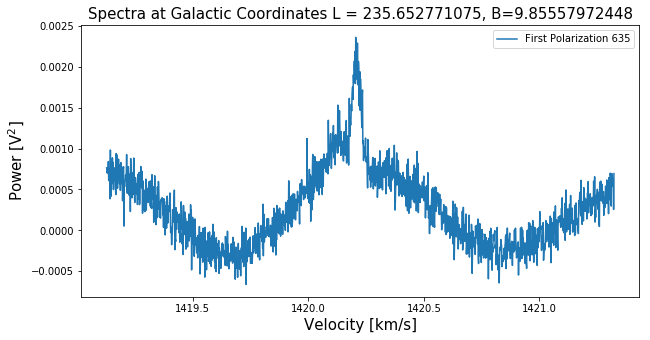

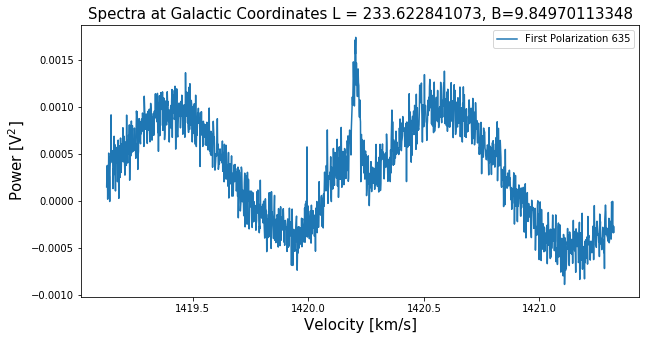

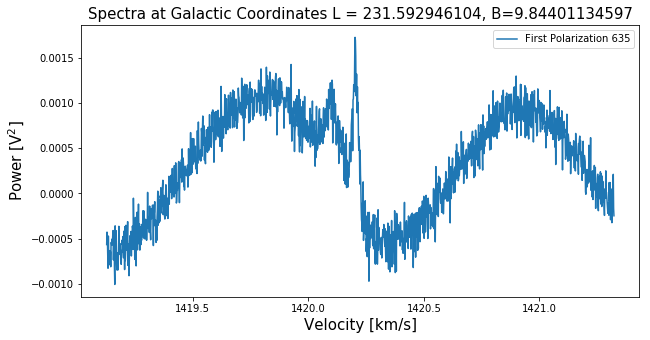

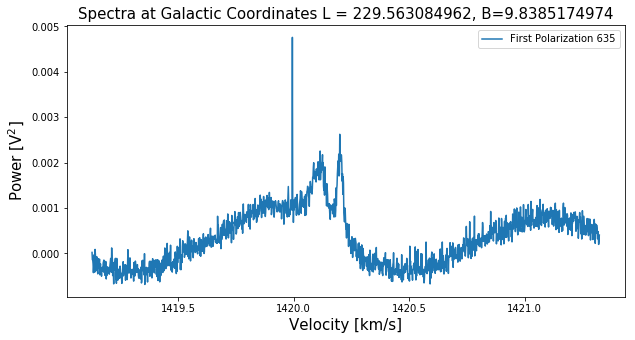

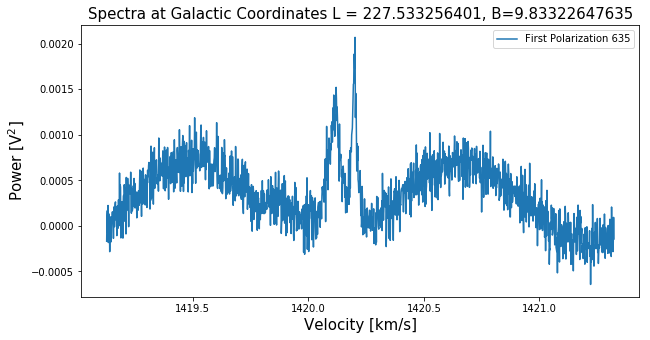

...

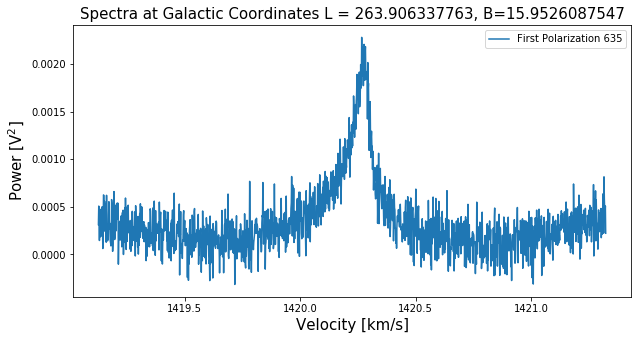

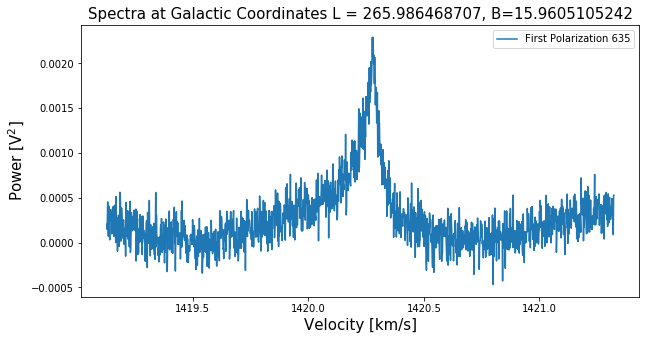

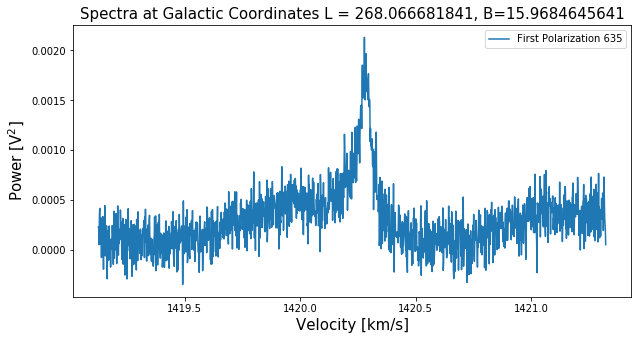

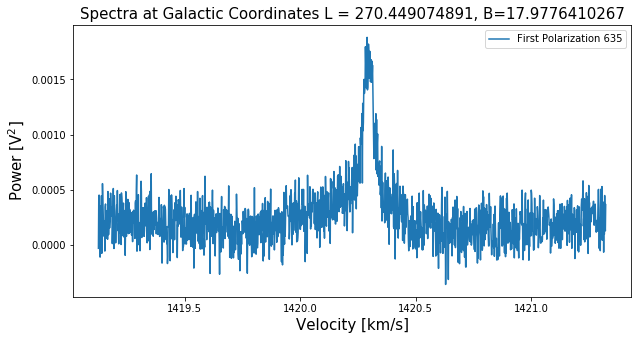

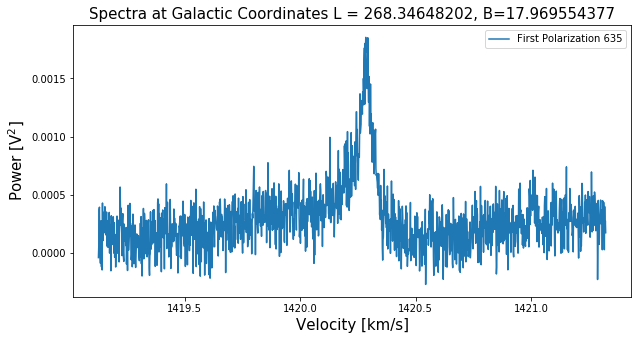

In [170]:
for k in range(int(len(files635[:100]))):
    plt.figure(figsize = (10,5))
    plt.plot(FREQS635[k][3500:5000],POLAR1635[k][3500:5000]-POLAR1636[k][3500:5000])
#     plt.plot(FREQS635[k][3500:5000],POLAR2635[k][3500:5000])
#     plt.plot(FREQS636[k][3500:5000],POLAR1636[k][3500:5000])
#     plt.plot(FREQS636[k][3500:5000],POLAR2636[k][3500:5000])
    
    plt.legend(['First Polarization 635','Second Polarization 635', 'First Polarization 636', 'Second Polarization 636'],loc='upper right')
    plt.title('Spectra at Galactic Coordinates' ' L = {}, B={}'.format(L635[k],B635[k]),fontsize = 15)
    plt.xlabel('Velocity [km/s]', fontsize = 15)
    plt.ylabel('Power [V$^2$]',fontsize = 15)
    plt.show()

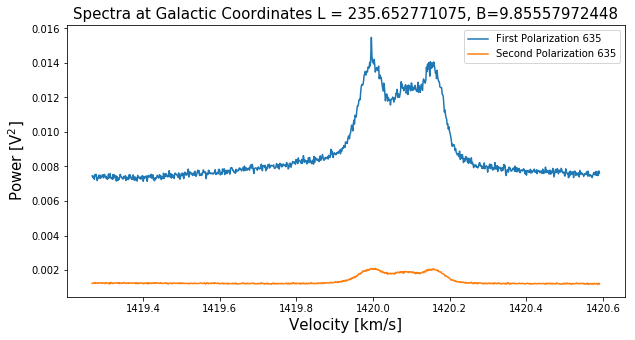

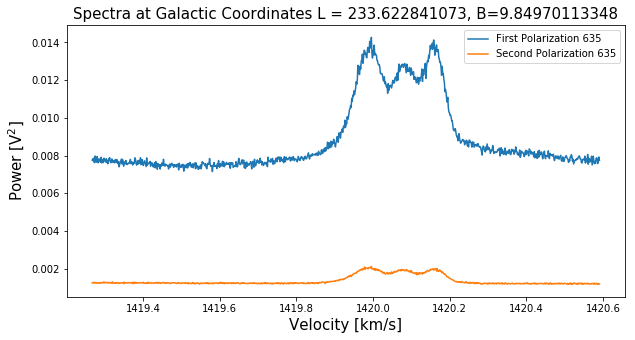

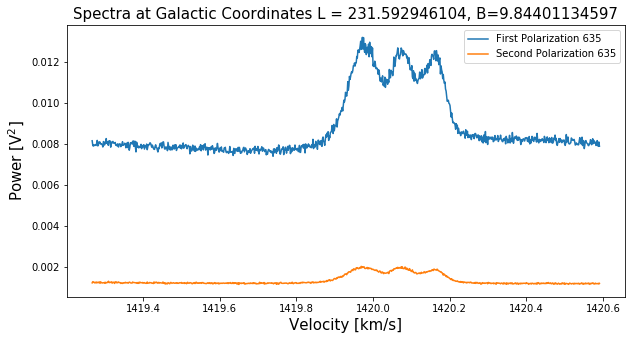

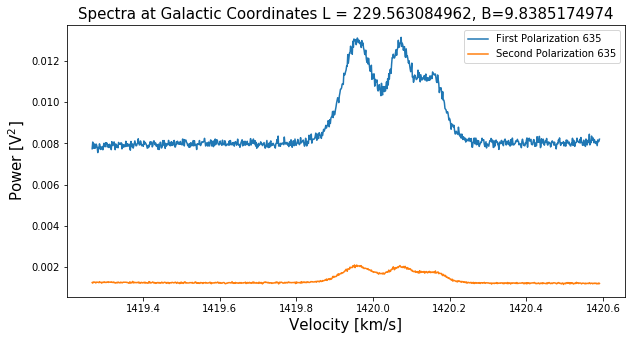

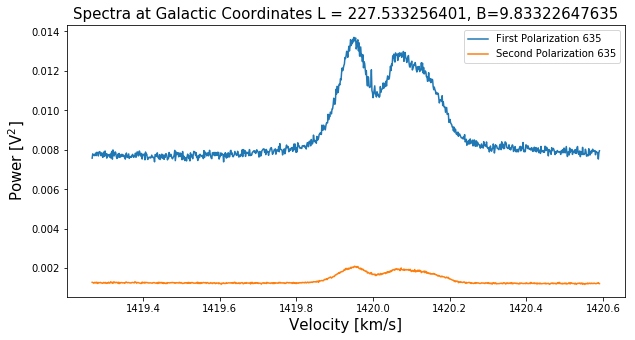

...

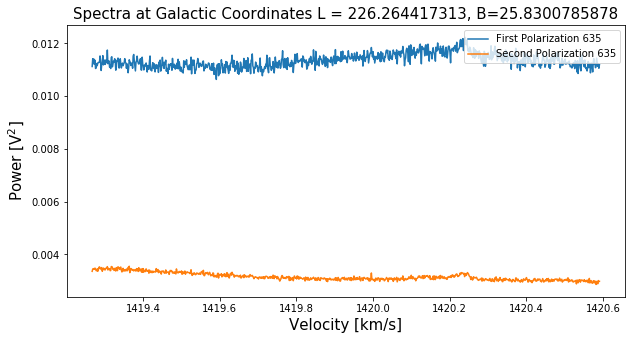

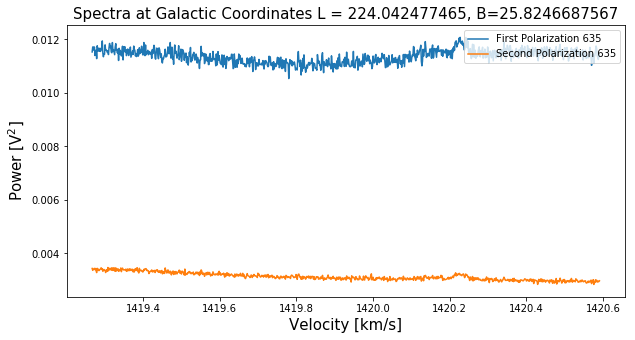

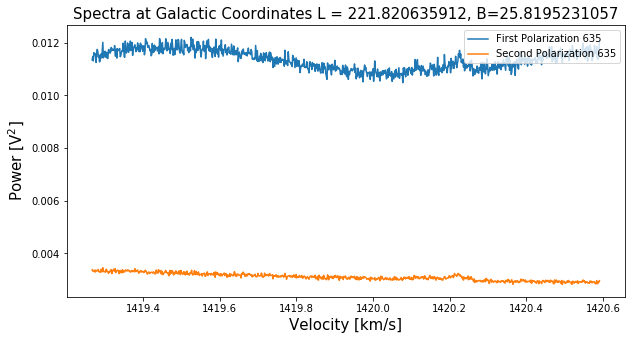

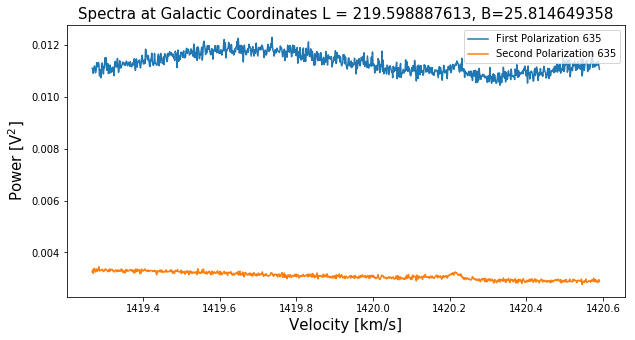

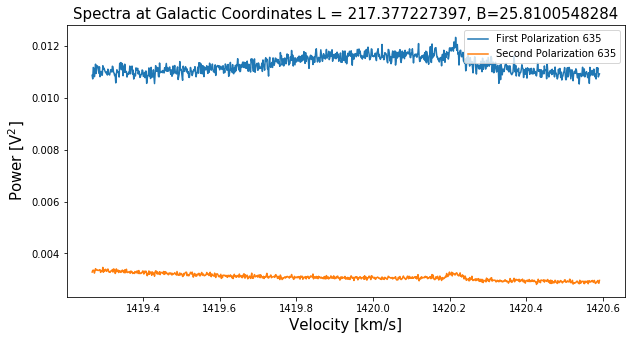

In [90]:
for k in range(int(len(filesnoise))):
    plt.figure(figsize = (10,5))
    plt.plot(FREQSnoise[k][int(len(FREQSnoise[k])/2)-500:4500],POLAR1noise[k][int(len(POLAR1noise[k])/2)-500:4500])
    plt.plot(FREQSnoise[k][int(len(FREQSnoise[k])/2)-500:4500],POLAR2noise[k][int(len(POLAR2noise[k])/2)-500:4500])
    
    
    plt.legend(['First Polarization 635','Second Polarization 635', 'First Polarization 636', 'Second Polarization 636'],loc='upper right')
    plt.title('Spectra at Galactic Coordinates' ' L = {}, B={}'.format(L635[k],B635[k]),fontsize = 15)
    plt.xlabel('Velocity [km/s]', fontsize = 15)
    plt.ylabel('Power [V$^2$]',fontsize = 15)
    plt.show()

In [108]:
L = np.concatenate([Lnoise,L635,L636])
B = np.concatenate([Bnoise,B635,B636])

In [124]:
def plot_galactic_sphere(l,b,org=0, projection='mollweide'):
    ''' l, b are arrays of the same length.
    l takes values in [0,360), b in [-90,90],
    which represent angles in degrees.
    org is the origin of the plot, 0 or a multiple of 30 degrees in [0,360).
    title is the title of the figure.
    projection is the kind of projection: 'mollweide', 'aitoff', 'hammer', 'lambert'
    '''
    x = np.remainder(l+360,360) # shift az values
    ind = x>180
    x[ind] -=360    # scale conversion to [-180, 180]    
    tick_labels = np.array([210, 240, 270, 300, 330, 0, 30, 60, 90, 120, 150])
    tick_labels = np.remainder(tick_labels+360+org,360)
    fig = plt.figure(figsize=(10, 5))
    ax = fig.add_subplot(111, projection=projection)
    ax.scatter(np.radians(x),np.radians(b))  # convert degrees to radians
    ax.set_xticklabels(tick_labels)     # we add the scale on the x axis
    ax.set_title('North Polar Spur Observations ')
    ax.title.set_fontsize(15)
    ax.set_xlabel("Galactic Longitude [$\degree$]",fontsize = 30)
    ax.xaxis.label.set_fontsize(12)
    ax.set_ylabel("Galactic Latitude [$\degree$]",fontsize=30)
    ax.yaxis.label.set_fontsize(12)
   
    ax.grid(True)

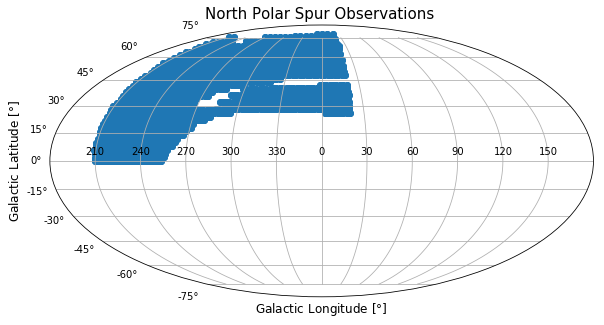

In [126]:
plot_galactic_sphere(L,B)

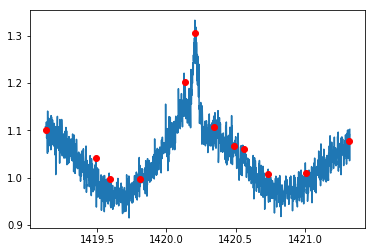

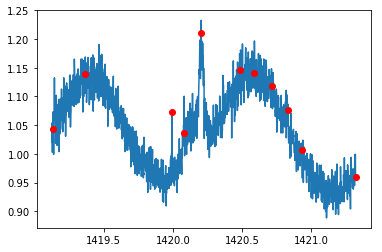

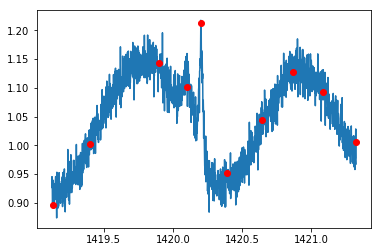

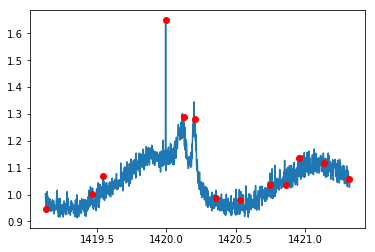

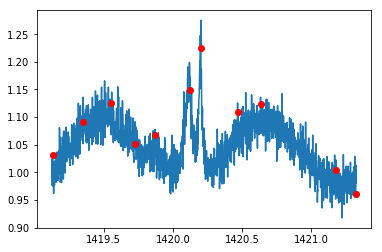

...

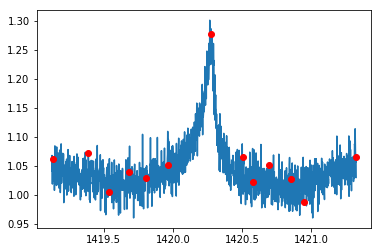

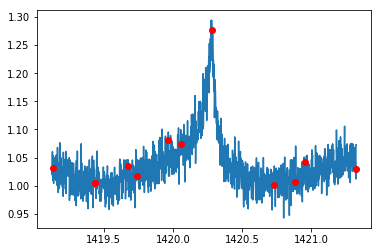

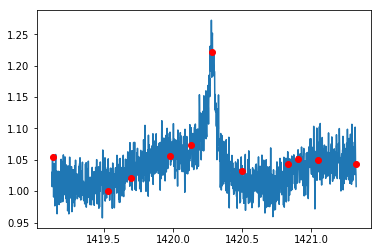

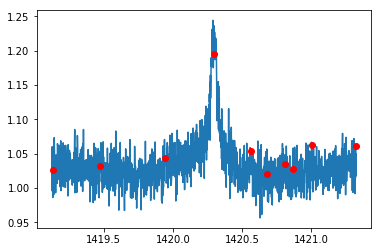

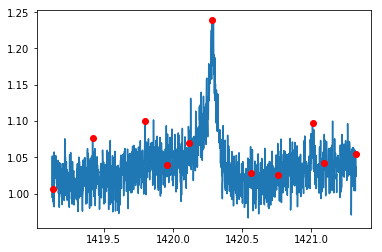

In [175]:
from scipy import signal
for i in range(int(len(files635[:100]))):
    data = POLAR1635[i][3500:5000]/POLAR1636[i][3500:5000]
    peakind = signal.find_peaks_cwt(data, np.arange(1,100))
    peakind, FREQS635[i][3500:5000][peakind], data[peakind]
    plt.figure()
    plt.plot(FREQS635[i][3500:5000],data)
    plt.plot(FREQS635[i][3500:5000][peakind],data[peakind],'ro')
    plt.show()

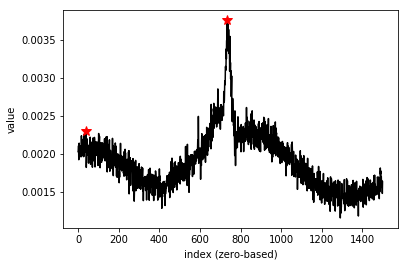

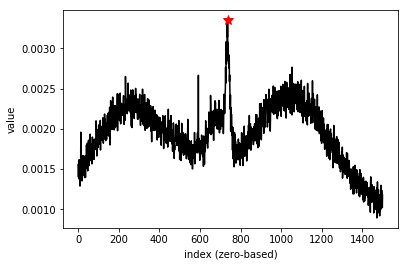

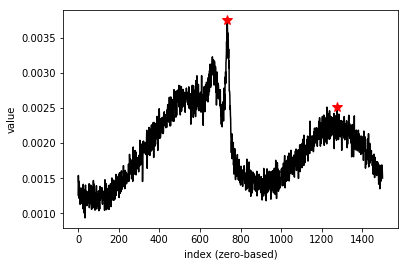

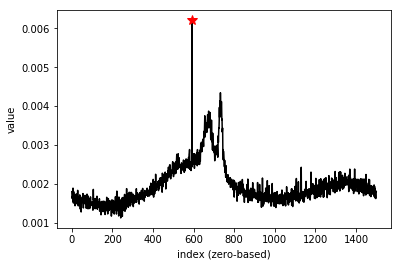

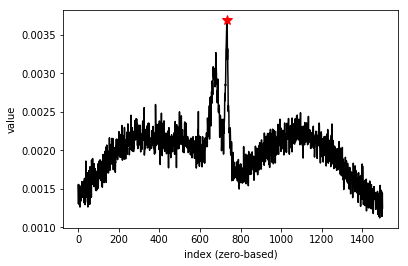

...

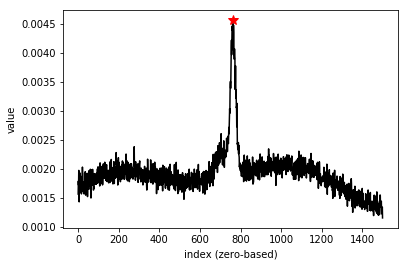

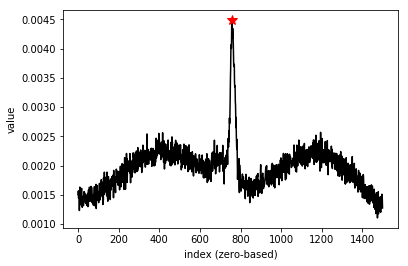

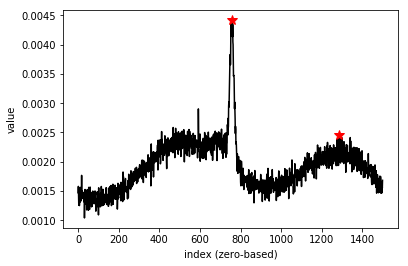

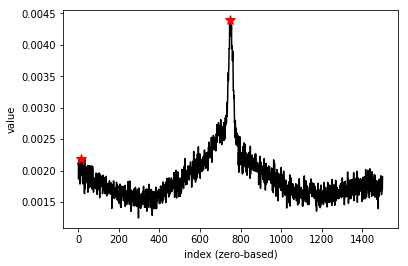

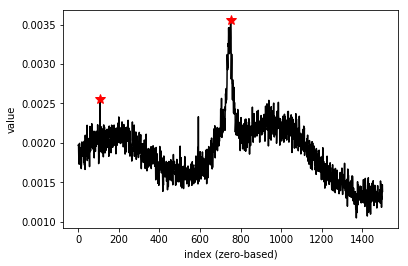

KeyboardInterrupt: 

In [187]:
from numpy import array
from scipy.signal import argrelmax
from matplotlib.pyplot import figure,show
for i in range(int(len(files635))):
    data = POLAR1635[i][3500:5000] - np.mean(POLAR1635[i])
    pkind = array(argrelmax(data,order=500))

    ax= figure().gca()
    ax.plot(data,color='k')
    ax.plot(pkind,data[pkind],linestyle='none',marker='*',markersize=10,color='r')
    ax.set_xlabel('index (zero-based)')
    ax.set_ylabel('value')

    show()